# Validation of Shapes & Cities

@roman

Oct 6, 2024

---
# Settings

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import uuid
import h3
import os
import networkx as nx
from shapely.geometry import Polygon

from INEGIpy import MarcoGeoestadistico

from sklearn.cluster import DBSCAN
from scipy.spatial import KDTree

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [2]:
# Settings
# show 100 columns in pandas
pd.set_option('display.max_columns', 100)
geo_framework = MarcoGeoestadistico()

---
# Data

## Cities

In [3]:
# read parquet
folder_data = '../../data/misc'
gdf_cities = gpd.read_parquet(f"{folder_data}/cities_clusters_v1_raw.parquet")
gdf_cities_v2 = gpd.read_parquet(f"{folder_data}/cities_clusters_v2_raw.parquet")

# look at the data
gdf_cities.head()

,cluster,geometry,state_id,municipality_id,properties
0,0,"POLYGON ((3785383.781 1054794.370, 3784042.753...",31,050,1593
1,1,"POLYGON ((3788629.093 1045564.374, 3786323.688...",31,041,2927
2,2,"POLYGON ((3784189.289 1044967.272, 3784046.380...",31,041,565
3,3,"POLYGON ((3788312.710 1048575.219, 3787283.883...",31,041,3431
4,4,"POLYGON ((2098434.995 1848325.035, 2098135.691...",08,019,11778


In [4]:
# see how many cities we have
gdf_cities.shape

(3518, 5)

In [5]:
# see
gdf_cities.explore(tiles='cartodb positron')

---
# Cities

## S1: Re-Clustering Using Graphs

### Buffer

In [7]:
# meters to buffer
METERS_BUFFER = 2_500

# buffer cities
gdf = (
    gdf_cities
    .copy()
    # buffer
    .assign(geometry=lambda x: x.buffer(METERS_BUFFER))
)

# see buffered data
gdf.explore(tiles='cartodb positron')

### Nodes & Edges

In [8]:
# Step 1: Initialize an empty graph
G = nx.Graph()

# Step 2: Add nodes (geometries) to the graph
print(f"Adding nodes to the graph...")
for i, geom in tqdm(enumerate(gdf.geometry)):
    G.add_node(i, geometry=geom)

# Step 3: Add edges for intersections
print(f"Adding edges to the graph...")
for i in tqdm(range(len(gdf))):
    for j in range(i+1, len(gdf)):
        if gdf.geometry[i].intersects(gdf.geometry[j]):
            G.add_edge(i, j)

Adding nodes to the graph...


3518it [00:00, 385453.92it/s]


Adding edges to the graph...


100%|██████████| 3518/3518 [02:30<00:00, 23.43it/s] 


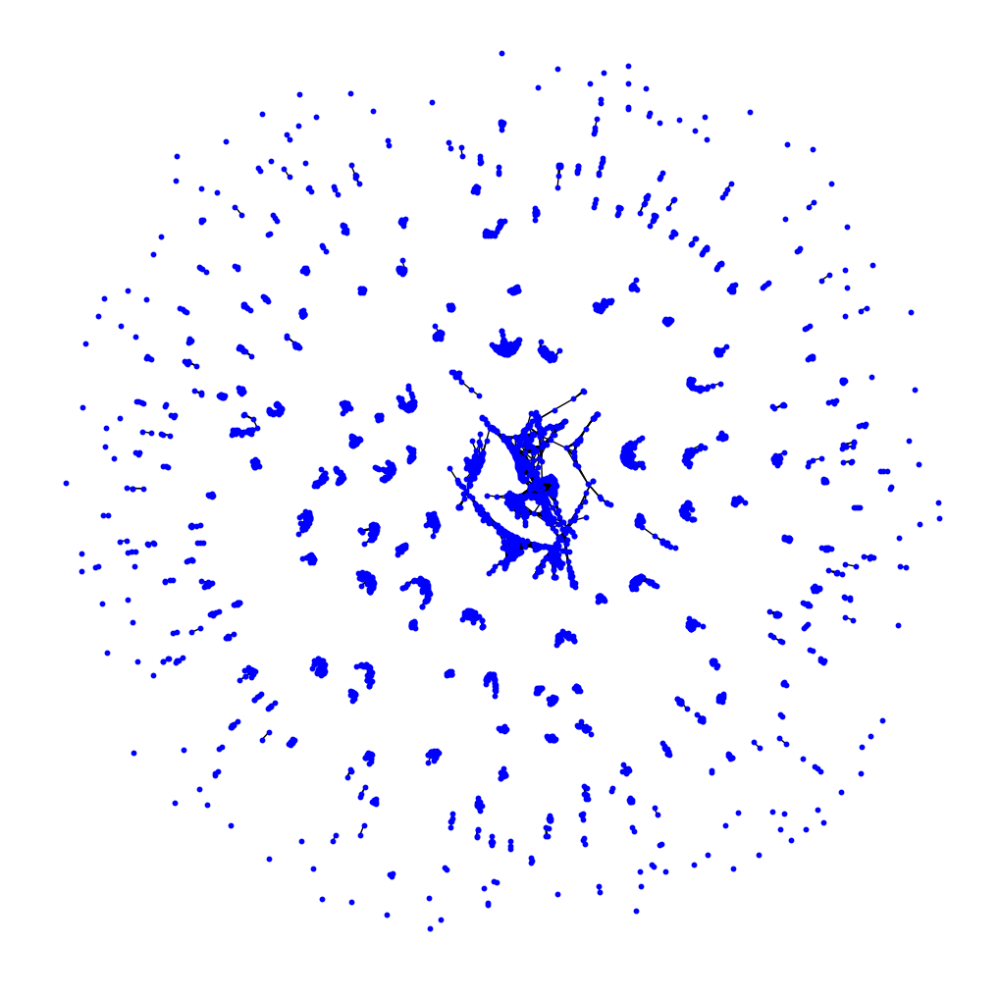

In [9]:
# see the graph
plt.figure(figsize=(10, 10))
nx.draw(G, node_size=10, node_color='blue', with_labels=False)
plt.show()

### Connected components

In [10]:
# Step 4: Find connected components (clusters of intersecting geometries)
connected_components = list(nx.connected_components(G))

# Step 5: Create dataframes for each cluster
list_clusters = []
for i, cluster in enumerate(connected_components):
    df_cluster = gdf.iloc[list(cluster)].copy()
    df_cluster['new_cluster'] = i
    list_clusters.append(df_cluster)

# Step 6: Merge all clusters into a single dataframe
df_clusters = pd.concat(list_clusters)

# Step 7: Subset columns
df_clusters = df_clusters[['new_cluster', 'cluster']]

# Step 8: Merge with original data
gdf_cities_final_v1 = (
    gdf_cities
    .merge(df_clusters, on='cluster')
    # dissolve by new cluster
    .dissolve(by='new_cluster', aggfunc='sum')
    .reset_index()
    .loc[:, ['new_cluster', 'properties', 'geometry']]
    )
gdf_cities_final_v1

,new_cluster,properties,geometry
0,0,45995,"MULTIPOLYGON (((3766613.839 1040041.179, 37666..."
1,1,38351,"MULTIPOLYGON (((2099294.633 1840875.935, 20993..."
2,2,47722,"MULTIPOLYGON (((2077038.721 2177846.642, 20770..."
3,3,4830,"MULTIPOLYGON (((3695844.334 914490.256, 369584..."
4,4,234593,"MULTIPOLYGON (((2661825.503 1512435.754, 26618..."
...,...,...,...
334,334,31,"POLYGON ((2984475.884 945549.019, 2984324.742 ..."
335,335,30,"POLYGON ((1568964.111 1582365.280, 1568911.461..."
336,336,30,"POLYGON ((2200944.784 1028301.056, 2200656.605..."
337,337,30,"POLYGON ((2105745.638 1223010.307, 2105667.152..."


In [11]:
# validate
gdf_cities_final_v1['properties'].sum()

1849686

In [12]:
# see the clusters
gdf_cities_final_v1.explore('new_cluster', tiles='cartodb positron')

In [17]:
# see clusters with less than N properties
N_MINIMUM = 1000

print(f"Clusters with less than {N_MINIMUM} properties: {gdf_cities_final_v1['properties'].lt(N_MINIMUM).mean()}")
(
    gdf_cities_final_v1
    .assign(
        min_properties=lambda x: x['properties'].ge(N_MINIMUM)
    )
    .explore('min_properties', tiles='cartodb positron', cmap='viridis')
)

Clusters with less than 1000 properties: 0.6548672566371682


### Get rid of small clusters

In [39]:
# get rid of clusters with less than N properties
gdf_cities_final_v1_subset = (
    gdf_cities_final_v1
    .query('properties >= @N_MINIMUM')
    .copy()
    .reset_index(drop=True)
    .assign(cluster=lambda x: x.index)
    .drop(columns=['new_cluster'])
    )
gdf_cities_final_v1_subset

,properties,geometry,cluster
0,45995,"MULTIPOLYGON (((3766613.839 1040041.179, 37666...",0
1,38351,"MULTIPOLYGON (((2099294.633 1840875.935, 20993...",1
2,47722,"MULTIPOLYGON (((2077038.721 2177846.642, 20770...",2
3,4830,"MULTIPOLYGON (((3695844.334 914490.256, 369584...",3
4,234593,"MULTIPOLYGON (((2661825.503 1512435.754, 26618...",4
...,...,...,...
112,1270,"MULTIPOLYGON (((2133846.938 1656207.328, 21338...",112
113,1044,"MULTIPOLYGON (((2808526.115 1190368.637, 28087...",113
114,1216,"MULTIPOLYGON (((2608338.884 1014339.465, 26083...",114
115,1137,"MULTIPOLYGON (((2401322.740 1522049.437, 24009...",115


In [43]:
# see how many properties we have in each cluster
gdf_cities_final_v1_subset['properties'].sum()

1795355

### Convex Hull

In [41]:
# create convex hull
gdf_cities_final_v1_subset['geometry'] = gdf_cities_final_v1_subset.convex_hull

In [42]:
# plot
gdf_cities_final_v1_subset.explore('cluster', tiles='cartodb positron')

### Repeat process

In [44]:
# repeat the process for gdf_cities_final_v1_subset
# Step 0: Buffer
BUFFER_METERS = 3_000
gdf = (
    gdf_cities_final_v1_subset
    .copy()
    # buffer
    .assign(geometry=lambda x: x.buffer(BUFFER_METERS))
)

# Step 1: Initialize an empty graph
G = nx.Graph()

# Step 2: Add nodes (geometries) to the graph
print(f"Adding nodes to the graph...")
for i, geom in tqdm(enumerate(gdf.geometry)):
    G.add_node(i, geometry=geom)

# Step 3: Add edges for intersections
print(f"Adding edges to the graph...")
for i in tqdm(range(len(gdf))):
    for j in range(i+1, len(gdf)):
        if gdf.geometry[i].intersects(gdf.geometry[j]):
            G.add_edge(i, j)

# Step 4: Find connected components (clusters of intersecting geometries)
print(f"Finding connected components...")
connected_components = list(nx.connected_components(G))

# Step 5: Create dataframes for each cluster
print(f"Creating dataframes for each cluster...")
list_clusters = []
for i, cluster in enumerate(connected_components):
    df_cluster = gdf.iloc[list(cluster)].copy()
    df_cluster['new_cluster'] = i
    list_clusters.append(df_cluster)

# Step 6: Merge all clusters into a single dataframe
print(f"Merging all clusters into a single dataframe...")
df_clusters = pd.concat(list_clusters)

# Step 7: Subset columns
print(f"Subsetting columns...")
df_clusters = df_clusters[['new_cluster', 'cluster']]

# Step 8: Merge with original data
print(f"Merging with original data...")
gdf_cities_final_v2 = (
    gdf_cities_final_v1_subset
    .merge(df_clusters, on='cluster')
    # dissolve by new cluster
    .dissolve(by='new_cluster', aggfunc='sum')
    .reset_index()
    .loc[:, ['new_cluster', 'geometry']]
    # convex hull
    .assign(geometry=lambda x: x.convex_hull)
    # reset index
    .reset_index(drop=True)
    # assign cluster
    .assign(cluster=lambda x: x.index)
    # drop new cluster
    .drop(columns=['new_cluster'])
    # buffer 1km
    .assign(geometry=lambda x: x.buffer(1_000))
    )


Adding nodes to the graph...


117it [00:00, 3042.12it/s]


Adding edges to the graph...


100%|██████████| 117/117 [00:00<00:00, 540.61it/s]


Finding connected components...
Creating dataframes for each cluster...
Merging all clusters into a single dataframe...
Subsetting columns...
Merging with original data...


In [45]:
# see the buffer
gdf.explore(tiles='cartodb positron')

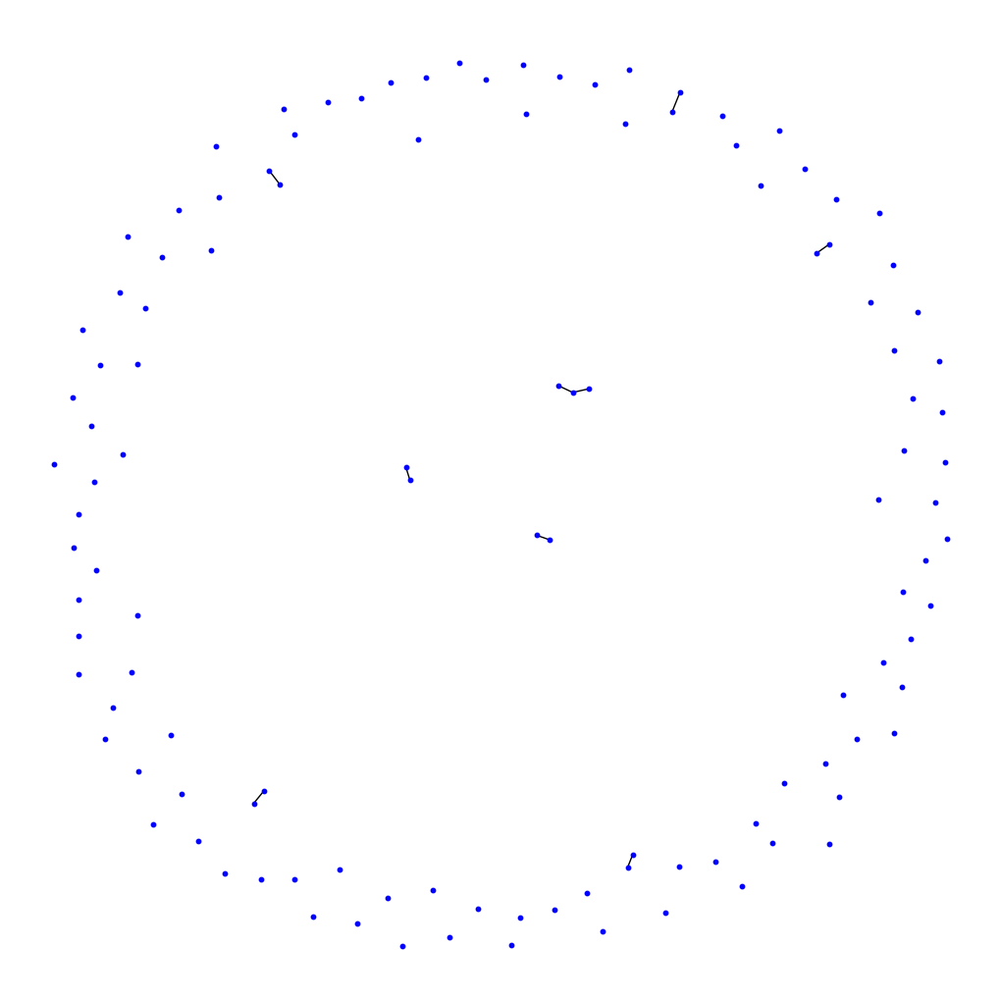

In [46]:
# see the graph
plt.figure(figsize=(10, 10))
nx.draw(G, node_size=10, node_color='blue', with_labels=False)
plt.show()

In [48]:
# see
print(gdf_cities_final_v2.shape)
gdf_cities_final_v2.explore('cluster', tiles='cartodb positron')

(108, 2)


### Join with properties

In [49]:
# read parquet
gdf_properties = (
    pd.read_parquet("../../data/raw/appraisals.parquet")
    .assign(
        geometry=lambda x: gpd.points_from_xy(x.longitude, x.latitude)
    )
    .pipe(gpd.GeoDataFrame, crs='EPSG:4326')
    .drop(columns=['latitude', 'longitude'])
    .assign(
        state_id=lambda x: x['state_id'].astype(str).str.zfill(2),
        municipality_id=lambda x: x['municipality_id'].astype(str).str.zfill(3)
    )
)
# see
print(gdf_properties.shape)
gdf_properties.head()


(2339244, 59)


,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,property_account_id,special_common_installations_description,special_private_installations_description,complementary_common_works_description,age_in_months,parking_lots,valuation_date,common_areas_completion_percentage,private_works_completion_percentage,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,level,total_levels,purpose_of_appraisal,bedrooms,accessory_area,built_area,saleable_area,land_area,distance_to_public_transportation,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry
0,1,2,4,VISTA HERMOSA HUITEPEC,NO APLICA,29263,<NA>,<NA>,<NA>,<NA>,36,1,2022-06-14,NaN,100.0,NaN,NaN,NaN,NaN,4,4,301ef216-0137-4989-bdd0-32bf1adf1e9b,0.0,07,1,NaN,1,2,078,6f8c15c7-2914-40bb-87ff-59076af288c9,3,NaN,NaN,NaN,2,NaN,35a7806a-f686-4159-be91-16997e86d271,87aa63b6-9005-4ed3-ba44-fcd75453a9e9,3,3,S/D,3,10.750000,216.809998,227.559998,302.700012,NaN,1.0,NaN,<NA>,3716737.0,3717000.0,2532281.13,1033417.8,<NA>,67,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1,POINT (-92.67266 16.73728)
1,1,2,4,MAYA,NO APLICA,97134,<NA>,<NA>,<NA>,<NA>,204,1,2022-11-15,NaN,100.0,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,3,2,S/D,3,13.380000,141.550003,154.929993,198.000000,NaN,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,984852.0,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (-89.57519 21.01430)
2,0,1,3,KANASIN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,60,1,2022-06-22,NaN,100.0,NaN,NaN,NaN,NaN,3,5,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,a7f6ef17-0933-4138-9aa9-99529929184d,3,1,S/D,2,1.120000,44.349998,45.470001,144.800003,NaN,1.0,NaN,<NA>,446378.0,450000.0,279611.30,102663.2,<NA>,55,e57ad294-8db8-4ca1-b01f-7ccbc5981922,552216f4-540b-500d-a4e7-6be55b2b6703,POINT (-89.54664 20.92895)
3,0,1,3,MULCHECHEN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,192,1,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,3,1,S/D,2,2.160000,52.049999,54.209999,133.750000,NaN,1.0,NaN,<NA>,424468.0,424000.0,290492.55,96835.0,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (-89.58095 20.91690)
4,0,3,4,POBLACION MOTUL,NO APLICA,97430,<NA>,<NA>,<NA>,<NA>,116,0,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,4,4,1f637d21-f0cb-43be-b989-5923e4c01d94,0.0,31,1,NaN,1,2,052,bc0e00ba-8c35-465f-bbcd-61cedf83d6d8,1,NaN,NaN,NaN,2,NaN,90a0a9f7-fab3-4170-b3da-db49e122e41b,f6e764a4-141c-4b02-b902-4a158ec58c58,3,2,S/D,2,19.049999,229.929993,248.979996,844.520020,NaN,1.0,NaN,<NA>,2779000.0,2779000.0,1767043.79,641835.2,<NA>,39,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41,POINT (-89.28537 21.09639)


In [50]:
# join properties with cities
gdf_properties_in_cities = (
    gdf_properties
    .loc[:, ['observation_id', 'property_id', 'geometry']]
    .to_crs('EPSG:6372')
    .sjoin(
        gdf_cities_final_v2[['cluster', 'geometry']],
        predicate='within',
        how='left'
    )
    .drop(columns='index_right')
)

# see
gdf_properties_in_cities

,observation_id,property_id,geometry,cluster
0,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1,POINT (3495349.900 560385.314),NaN
1,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (3784284.380 1056168.461),0.0
2,e57ad294-8db8-4ca1-b01f-7ccbc5981922,552216f4-540b-500d-a4e7-6be55b2b6703,POINT (3788044.004 1047053.055),0.0
3,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (3784619.353 1045421.310),0.0
4,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41,POINT (3813363.000 1067806.582),NaN
...,...,...,...,...
2339239,37654447-0969-4431-be8c-5b4b0e7114a0,3cb8ed2e-b653-5bd1-97c1-d47c6c00b794,POINT (2780352.745 843409.208),10.0
2339240,a1fa946a-4115-48eb-ae05-f7ef6d6f38be,da803a1d-bb97-5af2-8e9c-5525f24a988e,POINT (2606364.446 1489654.642),38.0
2339241,329df60f-82e3-4254-81ca-6b0b0e464c8f,8034e2ce-0b84-5313-afd8-7a95421f7951,POINT (2697997.828 1470729.998),NaN
2339242,2da5a70e-33e0-473e-a0d1-eb3747a0066b,da36c0d9-7340-51d7-8d28-89125cebc7bc,POINT (2653814.001 1515153.008),4.0


In [51]:
# how many properties are in cities
print(gdf_properties_in_cities['cluster'].notnull().mean())
print(gdf_properties_in_cities['cluster'].notnull().sum())

0.9381539505925847
2194571


In [52]:
# see how many properties are in each cluster
tbl_properties = (
    gdf_properties_in_cities
    .groupby('cluster')
    .size()
    .reset_index(name='total_properties')
    .sort_values('total_properties', ascending=False)
)
tbl_properties

,cluster,total_properties
10,10.0,309995
4,4.0,264540
11,11.0,183804
7,7.0,82756
30,30.0,60779
...,...,...
105,105.0,1471
94,94.0,1340
106,106.0,1317
89,89.0,1273


In [53]:
# join counts with cities
gdf_cities_final_v2 = (
    gdf_cities_final_v2
    .merge(tbl_properties, on='cluster', how='left')
)
gdf_cities_final_v2

,geometry,cluster,total_properties
0,"POLYGON ((3766167.134 1038856.678, 3766075.742...",0,55550
1,"POLYGON ((2106201.674 1838908.292, 2106105.496...",1,43549
2,"POLYGON ((2083964.935 2167068.796, 2083854.591...",2,53833
3,"POLYGON ((3695976.760 913468.113, 3695883.500 ...",3,5495
4,"POLYGON ((2691489.214 1478562.321, 2691414.834...",4,264540
...,...,...,...
103,"POLYGON ((2137136.876 1654507.534, 2137044.232...",103,1956
104,"POLYGON ((2809075.793 1188762.402, 2808986.206...",104,1689
105,"POLYGON ((2608508.314 1013348.771, 2608407.574...",105,1471
106,"POLYGON ((2401691.811 1520986.348, 2401617.754...",106,1317


In [54]:
# see
gdf_cities_final_v2['total_properties'].sort_values(ascending=False)

10     309995
4      264540
11     183804
7       82756
30      60779
        ...  
105      1471
94       1340
106      1317
89       1273
100      1256
Name: total_properties, Length: 108, dtype: int64

In [55]:
# see how many cities have less than 1000 properties
print(gdf_cities_final_v2['total_properties'].lt(1000).sum())

0


In [57]:
# plot
(
    gdf_cities_final_v2
    .explore('total_properties', tiles='cartodb positron', cmap='viridis')
    )

---
# Sandbox

In [58]:
gdf_cities

,cluster,geometry,state_id,municipality_id,properties
0,0,"POLYGON ((3785383.781 1054794.370, 3784042.753...",31,050,1593
1,1,"POLYGON ((3788629.093 1045564.374, 3786323.688...",31,041,2927
2,2,"POLYGON ((3784189.289 1044967.272, 3784046.380...",31,041,565
3,3,"POLYGON ((3788312.710 1048575.219, 3787283.883...",31,041,3431
4,4,"POLYGON ((2098434.995 1848325.035, 2098135.691...",08,019,11778
...,...,...,...,...,...
3513,3513,"POLYGON ((3454784.970 699562.102, 3454669.010 ...",27,013,32
3514,3514,"POLYGON ((2560538.079 963750.689, 2560529.420 ...",11,017,30
3515,3515,"POLYGON ((3785693.304 1060566.623, 3785668.200...",31,050,30
3516,3516,"POLYGON ((3016005.092 905606.284, 3015877.788 ...",30,102,31


In [59]:
df_clusters

,new_cluster,cluster
0,0,0
1,1,1
2,2,2
3,3,3
96,4,96
...,...,...
112,103,112
113,104,113
114,105,114
115,106,115


In [60]:
df_clusters.query("new_cluster==84")

,new_cluster,cluster
89,84,89


In [61]:
gdf_cities_final_v1

,new_cluster,properties,geometry
0,0,45995,"MULTIPOLYGON (((3766613.839 1040041.179, 37666..."
1,1,38351,"MULTIPOLYGON (((2099294.633 1840875.935, 20993..."
2,2,47722,"MULTIPOLYGON (((2077038.721 2177846.642, 20770..."
3,3,4830,"MULTIPOLYGON (((3695844.334 914490.256, 369584..."
4,4,234593,"MULTIPOLYGON (((2661825.503 1512435.754, 26618..."
...,...,...,...
334,334,31,"POLYGON ((2984475.884 945549.019, 2984324.742 ..."
335,335,30,"POLYGON ((1568964.111 1582365.280, 1568911.461..."
336,336,30,"POLYGON ((2200944.784 1028301.056, 2200656.605..."
337,337,30,"POLYGON ((2105745.638 1223010.307, 2105667.152..."


In [62]:
gdf_cities_final_v1.query("new_cluster==86")

,new_cluster,properties,geometry
86,86,56,"POLYGON ((3403593.701 657038.881, 3403311.631 ..."


In [63]:
gdf_cities_final_v1.explore(tile='cartodb positron')

In [38]:
gdf_cities_final_v1_subset.explore('cluster', tiles='cartodb positron')